### Zadania

Celem zadań jest napisanie (fragmentów) programów, które wyodrębnią obiekty znajdujące się na podanych obrazach. Rozumie się przez to doprowadzenie obrazów do postaci binarnej z wyraźną separacją między obiektami a tłem oraz poszczególnymi obiektami.

Samo osiągnięcie "jakiegoś" wyniku ([`cv2.threshold`](https://docs.opencv.org/3.4/d7/d1b/group__imgproc__misc.html#gae8a4a146d1ca78c626a53577199e9c57) odpalone, próg wybrany "z palca", _coś tam_ widać, wynik wyświetlony) to co najwyżej połowa sukcesu (i oceny). Ważne jest pokazanie w drodze eksperymentu odpowiedzi na pytania - czy te podane w treści zadania, czy takie, które się Tobie nasunęły.

In [2]:
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

##### Zad. 1: Monety szare

Dane są dwa czarno-białe obrazy monet, `monety_szare` oraz `monety_szare_szum`, z których drugi zawiera pewien poziom zakłóceń. Dokonaj binaryzacji tych obrazów za pomocą progowania.  
W jaki sposób ustalisz wartość progu? Jak wartość progu wpływa na wyniki?  
Jaki wpływ mają zakłócenia w drugim obrazie? Jak się ich pozbędziesz?

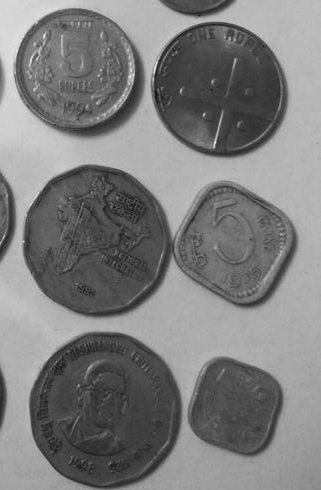

In [3]:
# 1A
monety_szare = cv2.imread('Monety_szare.bmp')
Image.fromarray(cv2.cvtColor(monety_szare, cv2.COLOR_BGR2RGB))

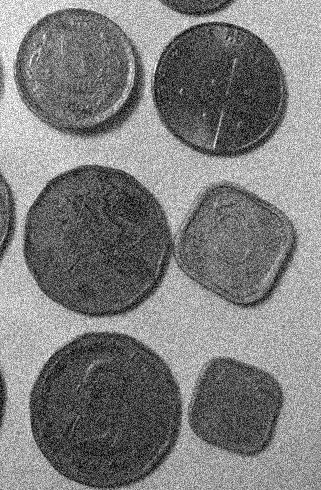

In [4]:
# 1B
monety_szare_szum = cv2.imread('Monety_szare_szum.bmp')
Image.fromarray(cv2.cvtColor(monety_szare_szum, cv2.COLOR_BGR2RGB))

Rozwiązanie części 1A:

In [5]:
#Zmiana obarzu na obraz w skali szarości
monety_szare_gray = cv2.cvtColor(monety_szare, cv2.COLOR_BGR2GRAY)

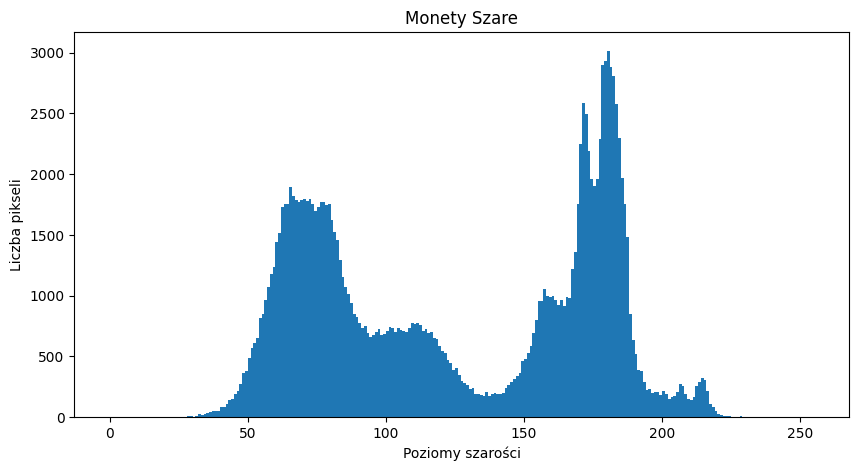

In [6]:
#Histogram pixeli obiektów (lewo) w stosunku do pixeli tła (prawo)
plt.figure(figsize=(10,5))
plt.hist(monety_szare_gray.flatten(), bins=255, range=(0, 255))
plt.title("Monety Szare")
plt.xlabel("Poziomy szarości")
plt.ylabel("Liczba pikseli")
plt.show()

In [11]:
#histogram
ret_monety_szare, binary_monety_szare = cv2.threshold(monety_szare_gray, 135, 255, cv2.THRESH_BINARY_INV)
#print("Ustalony próg:" , ret_monety_szare)
#Image.fromarray(binary_monety_szare) 

#algorytmu Otsu
ret_monety_szare_otsu, binary_monety_szare_otsu = cv2.threshold(monety_szare_gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
#print("Ustalony próg:" , ret_monety_szare_otsu)
#Image.fromarray(binary_monety_szare_otsu) 

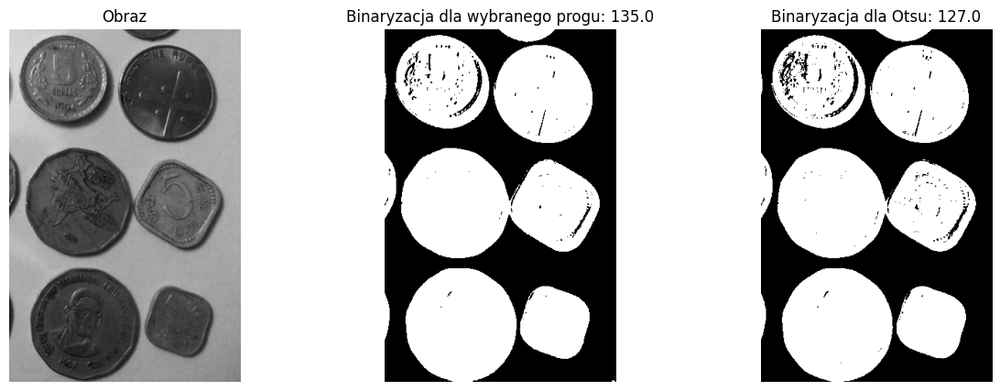

In [13]:
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.title("Obraz")
plt.imshow(monety_szare_gray, cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title(f"Binaryzacja dla wybranego progu: {ret_monety_szare}")
plt.imshow(binary_monety_szare, cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title(f"Binaryzacja dla Otsu: {ret_monety_szare_otsu}")
plt.imshow(binary_monety_szare_otsu, cmap='gray')
plt.axis('off')
plt.show()

Najlepszy próg: 127, MSE: 115.5177570093458


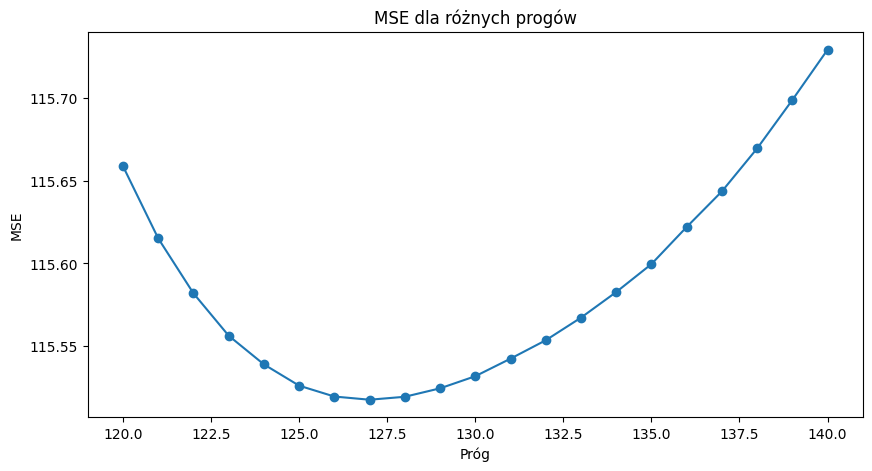

In [16]:
def calculate_mse(original, binary):
    return np.mean((original - binary) ** 2)

mse_values = []
for t in range(120, 141):
    ret, binary = cv2.threshold(monety_szare_gray, t, 255, cv2.THRESH_BINARY_INV)
    mse = calculate_mse(monety_szare_gray, binary)
    mse_values.append((t, mse))

best_threshold = min(mse_values, key=lambda x: x[1])
print(f"Najlepszy próg: {best_threshold[0]}, MSE: {best_threshold[1]}")

thresholds_list, mse_list = zip(*mse_values)
plt.figure(figsize=(10, 5))
plt.plot(thresholds_list, mse_list, marker='o')
plt.title('MSE dla różnych progów')
plt.xlabel('Próg')
plt.ylabel('MSE')
plt.show()


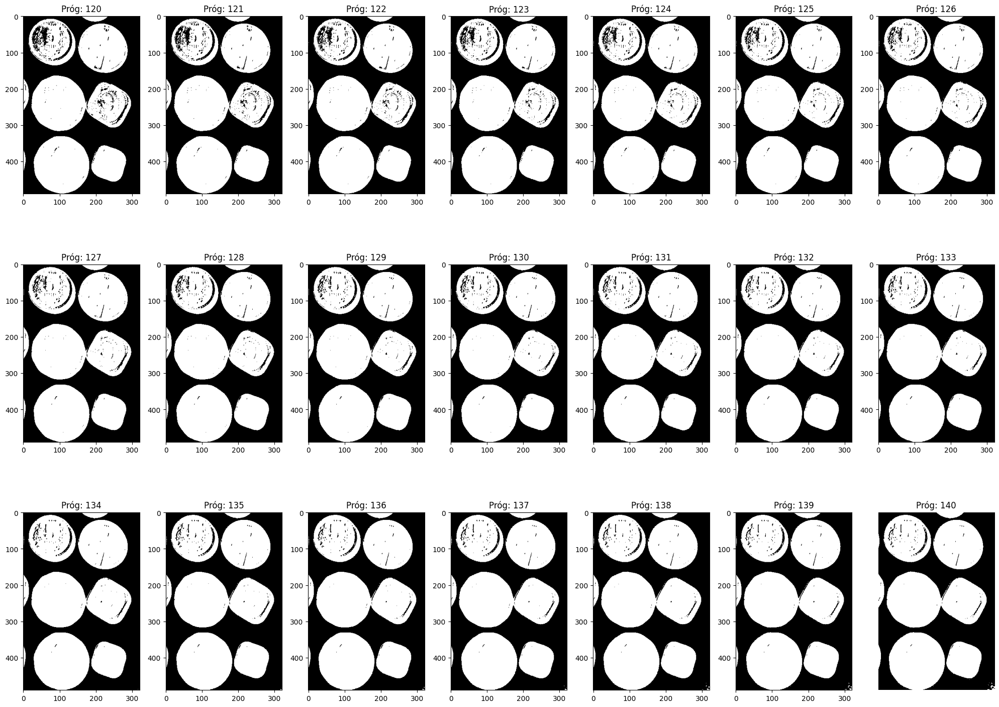

In [19]:
fig, axs = plt.subplots(3, 7, figsize=(20, 15))
axs = axs.flatten()
i = 0
for threshold in range(120, 141):
    (T, img_threshInv) = cv2.threshold(monety_szare_gray, threshold, 255, cv2.THRESH_BINARY_INV)
    axs[i].imshow(img_threshInv, cmap='gray')
    axs[i].set_title(f'Próg: {threshold}')
    i += 1

plt.tight_layout()

Rozwiązanie części 1B:


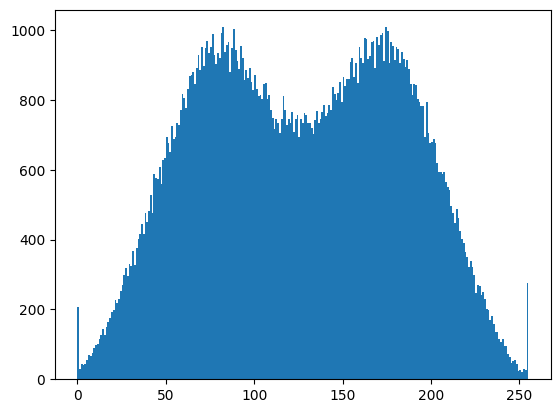

In [22]:
# Zmiana obarzu na obraz w skali szarości
monety_szare_szum_gray = cv2.cvtColor(monety_szare_szum, cv2.COLOR_BGR2GRAY)
monety_szum_hist = plt.hist(monety_szare_szum_gray.flatten(), bins=255, range=(0, 255))

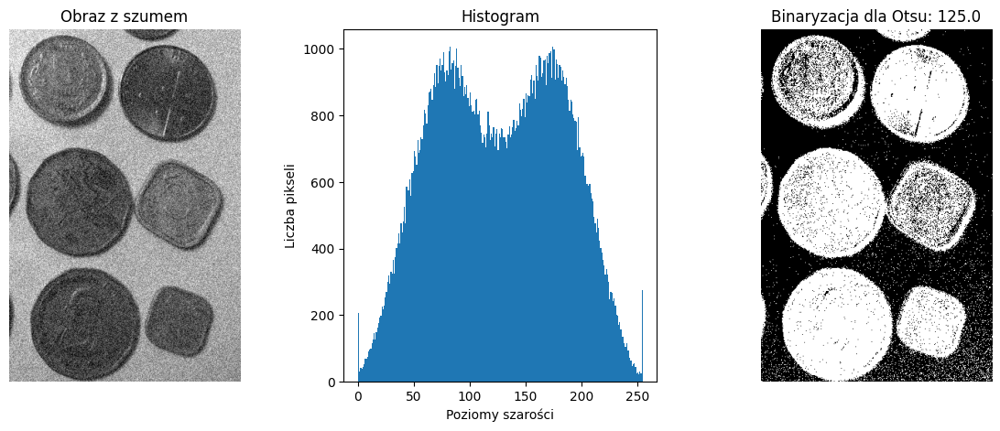

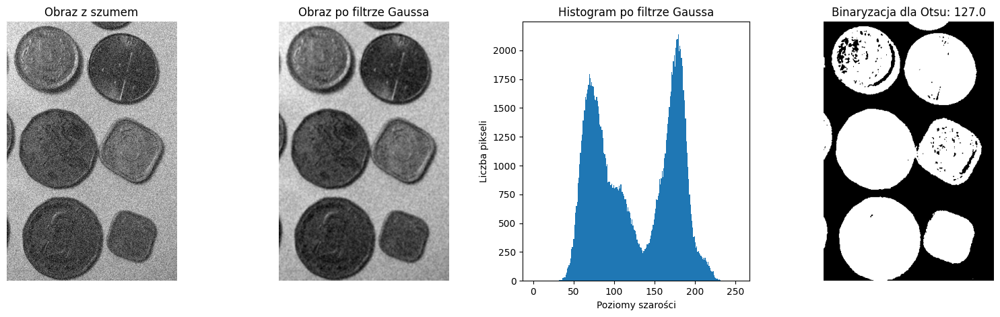

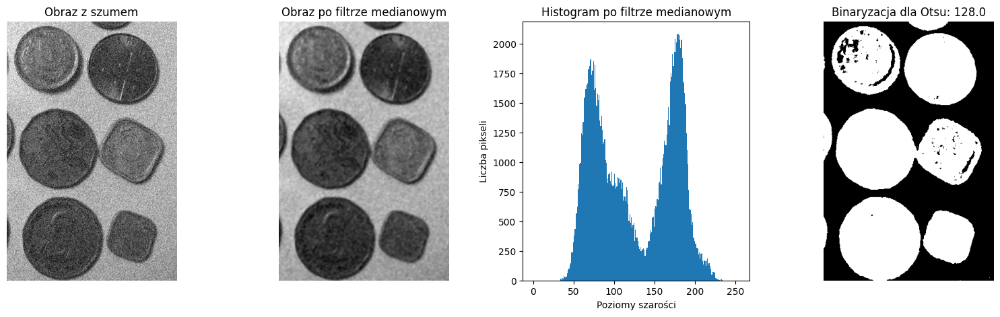

In [26]:
# Bez filtru
def nofilter():
    ret, otsu_image = cv2.threshold(monety_szare_szum_gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    plt.title("Obraz z szumem")
    plt.imshow(monety_szare_szum_gray, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.title("Histogram")
    plt.hist(monety_szare_szum_gray.flatten(), bins=255, range=(0, 255))
    plt.xlabel("Poziomy szarości")
    plt.ylabel("Liczba pikseli")

    plt.subplot(1, 3, 3)
    plt.title(f"Binaryzacja dla Otsu: {ret}")
    plt.imshow(otsu_image, cmap='gray')
    plt.axis('off')
    plt.show()

# Filtr Gaussa
def gaussian():
    blurred_image = cv2.GaussianBlur(monety_szare_szum_gray, (5, 5), 0)
    ret, otsu_blur_image = cv2.threshold(blurred_image, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

    plt.figure(figsize=(20, 5))

    plt.subplot(1, 4, 1)
    plt.title("Obraz z szumem")
    plt.imshow(monety_szare_szum_gray, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 4, 2)
    plt.title("Obraz po filtrze Gaussa")
    plt.imshow(blurred_image, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 4, 3)
    plt.title("Histogram po filtrze Gaussa")
    plt.hist(blurred_image.flatten(), bins=255, range=(0, 255))
    plt.xlabel("Poziomy szarości")
    plt.ylabel("Liczba pikseli")

    plt.subplot(1, 4, 4)
    plt.title(f"Binaryzacja dla Otsu: {ret}")
    plt.imshow(otsu_blur_image, cmap='gray')
    plt.axis('off')

    plt.show()

# Filtr Medianowy
def median():
    median_filtered = cv2.medianBlur(monety_szare_szum_gray, 5)
    ret_med, otsu_median = cv2.threshold(median_filtered, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

    plt.figure(figsize=(20, 5))

    plt.subplot(1, 4, 1)
    plt.title("Obraz z szumem")
    plt.imshow(monety_szare_szum_gray, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 4, 2)
    plt.title("Obraz po filtrze medianowym")
    plt.imshow(median_filtered, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 4, 3)
    plt.title("Histogram po filtrze medianowym")
    plt.hist(median_filtered.flatten(), bins=255, range=(0, 255))
    plt.xlabel("Poziomy szarości")
    plt.ylabel("Liczba pikseli")

    plt.subplot(1, 4, 4)
    plt.title(f"Binaryzacja dla Otsu: {ret_med}")
    plt.imshow(otsu_median, cmap='gray')
    plt.axis('off')

    plt.show()

nofilter()
gaussian()
median()

Najlepszy próg po filtrze Gaussa: 127, MSE: 112.36024540657384


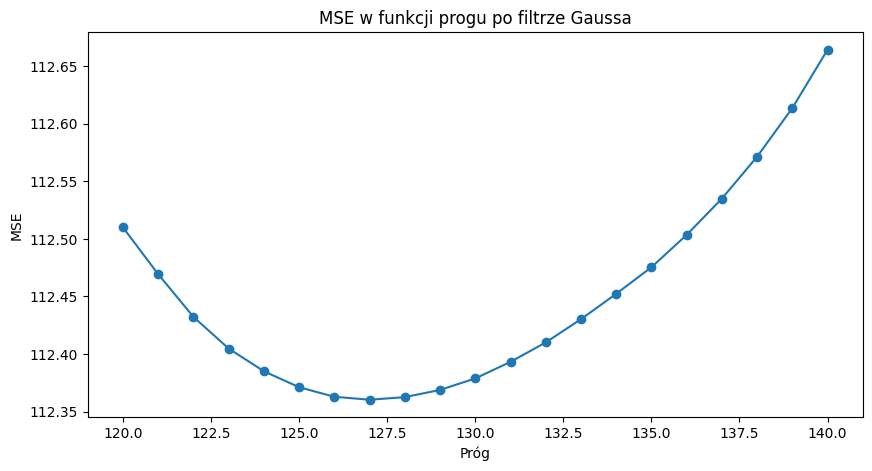

Najlepszy próg po filtrze medianowym: 127, MSE: 113.01082713459215


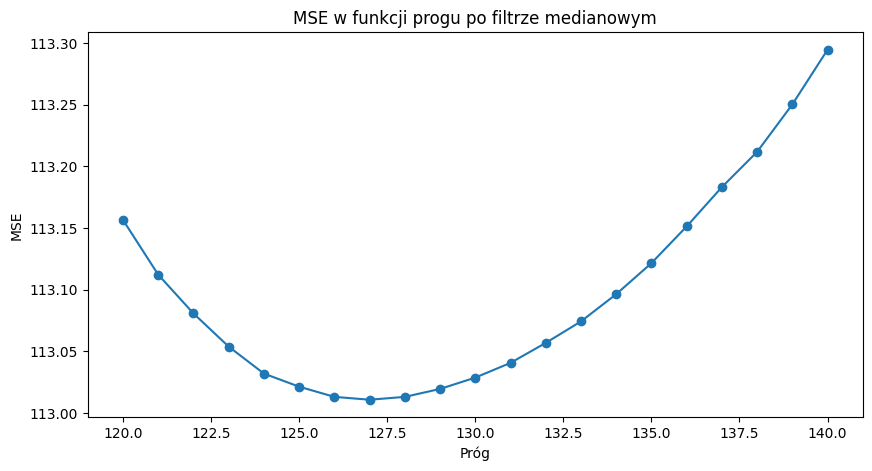

In [28]:
def mse_gaussian():
    blurred_image = cv2.GaussianBlur(monety_szare_szum_gray, (5, 5), 0)
    mse_values_gauss = []

    for t in range(120, 141):
        ret, binary = cv2.threshold(blurred_image, t, 255, cv2.THRESH_BINARY_INV)
        mse = calculate_mse(blurred_image, binary)
        mse_values_gauss.append((t, mse))

    best_threshold_gauss = min(mse_values_gauss, key=lambda x: x[1])
    print(f"Najlepszy próg po filtrze Gaussa: {best_threshold_gauss[0]}, MSE: {best_threshold_gauss[1]}")

    thresholds_list, mse_list = zip(*mse_values_gauss)
    plt.figure(figsize=(10, 5))
    plt.plot(thresholds_list, mse_list, marker='o')
    plt.title('MSE w funkcji progu po filtrze Gaussa')
    plt.xlabel('Próg')
    plt.ylabel('MSE')
    plt.show()

def mse_median():
    median_filtered = cv2.medianBlur(monety_szare_szum_gray, 5)
    mse_values_median = []

    for t in range(120, 141):
        ret, binary = cv2.threshold(median_filtered, t, 255, cv2.THRESH_BINARY_INV)
        mse = calculate_mse(median_filtered, binary)
        mse_values_median.append((t, mse))

    best_threshold_median = min(mse_values_median, key=lambda x: x[1])
    print(f"Najlepszy próg po filtrze medianowym: {best_threshold_median[0]}, MSE: {best_threshold_median[1]}")

    thresholds_list, mse_list = zip(*mse_values_median)
    plt.figure(figsize=(10, 5))
    plt.plot(thresholds_list, mse_list, marker='o')
    plt.title('MSE w funkcji progu po filtrze medianowym')
    plt.xlabel('Próg')
    plt.ylabel('MSE')
    plt.show()

mse_gaussian()
mse_median()


##### Zad. 2: Monety kolorowe

Na podobnej zasadzie dokonaj binaryzacji poniższych obrazów kolorowych. Skorzystaj z modelu barw HSV. Uzasadnij dobór progu w oparciu o histogram wybranej składowej.

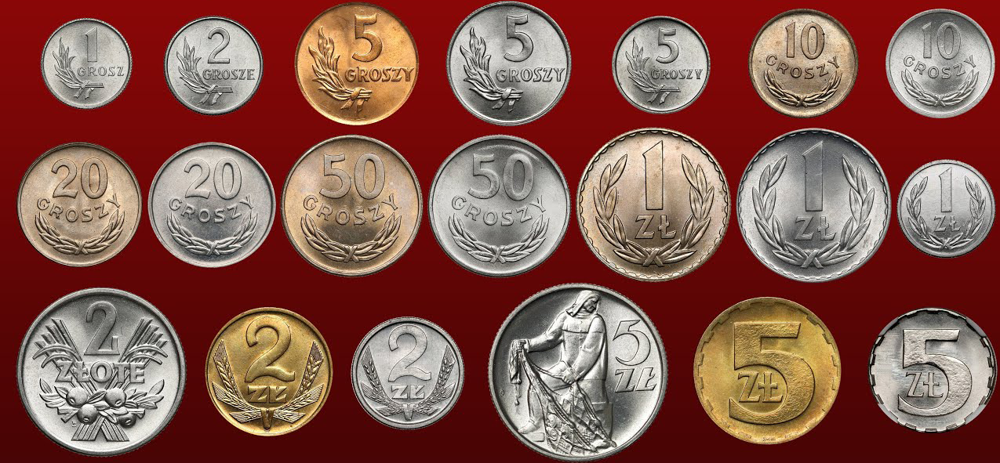

In [31]:
# 2A
monety_kolor = cv2.imread('Monety_kolor.bmp')
Image.fromarray(cv2.cvtColor(monety_kolor, cv2.COLOR_BGR2RGB))

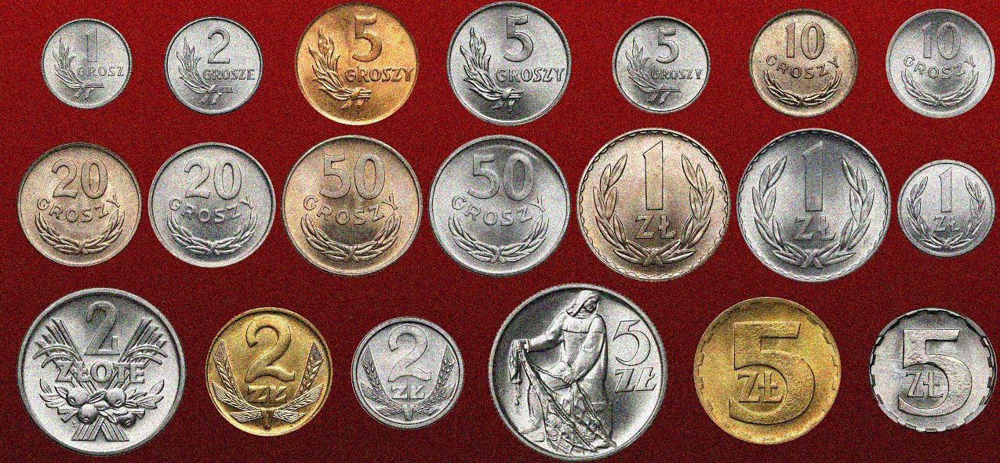

In [32]:
# 2B
monety_kolor_szum = cv2.imread('Monety_kolor_szum.bmp')
Image.fromarray(cv2.cvtColor(monety_kolor_szum, cv2.COLOR_BGR2RGB))

Rozwiązanie części 2A:

In [33]:
monety_hsv = cv2.cvtColor(monety_kolor, cv2.COLOR_BGR2HSV)
hue, saturation, value = cv2.split(monety_hsv)

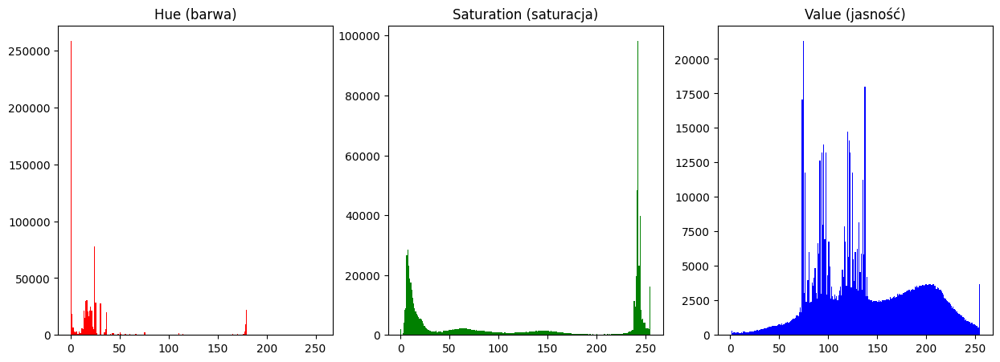

In [34]:
plt.figure(figsize=(15,5))
plt.subplot(1, 3, 1)
plt.title("Hue (barwa)")
plt.hist(hue.flatten(), bins=255, color='red', range=(0, 255))

plt.subplot(1, 3, 2)
plt.title("Saturation (saturacja)")
plt.hist(saturation.flatten(), bins=255, color='green', range=(0, 255))

plt.subplot(1, 3, 3)
plt.title("Value (jasność)")
plt.hist(value.flatten(), bins=255, color='blue', range=(0, 255))

plt.show()

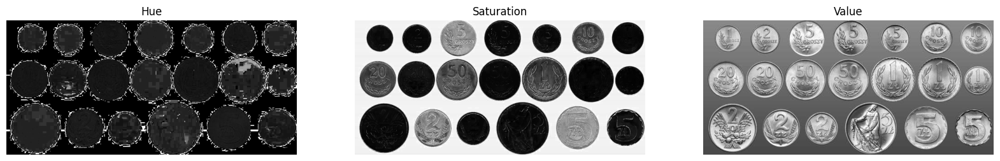

In [38]:
plt.figure(figsize=(20, 5))

plt.subplot(1, 3, 1)
plt.title(f"Hue")
plt.imshow(hue, cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title(f"Saturation")
plt.imshow(saturation, cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title(f"Value")
plt.imshow(value, cmap='gray')
plt.axis('off')

plt.show()

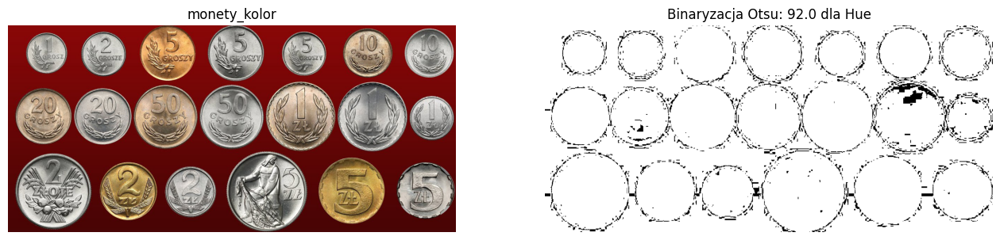

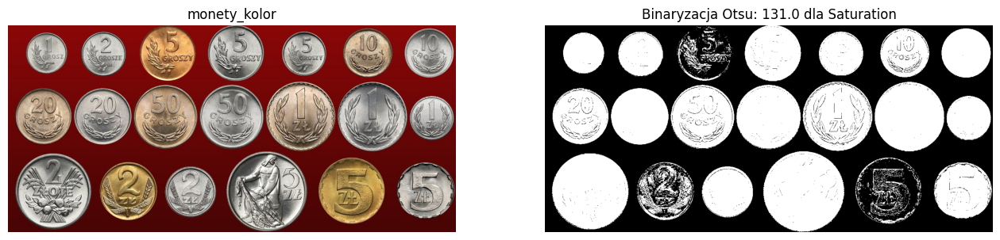

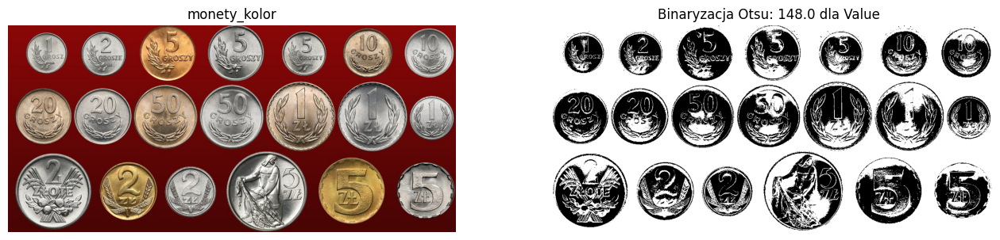

In [39]:
def channel_func(channel, channel_name, picture, picture_name):
    ret, binary = cv2.threshold(channel, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

    plt.figure(figsize=(16, 5))
    plt.subplot(1, 2, 1)
    plt.title(f'{picture_name}')
    plt.imshow(cv2.cvtColor(picture, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title(f"Binaryzacja Otsu: {ret} dla {channel_name}")
    plt.imshow(binary, cmap='gray')
    plt.axis('off')
    plt.show()

channel_func(hue, 'Hue', monety_kolor, 'monety_kolor')
channel_func(saturation, 'Saturation', monety_kolor, 'monety_kolor')
channel_func(value, 'Value', monety_kolor, 'monety_kolor')

Najlepszy próg dla Saturation: 50, MSE: 118.98308483461066


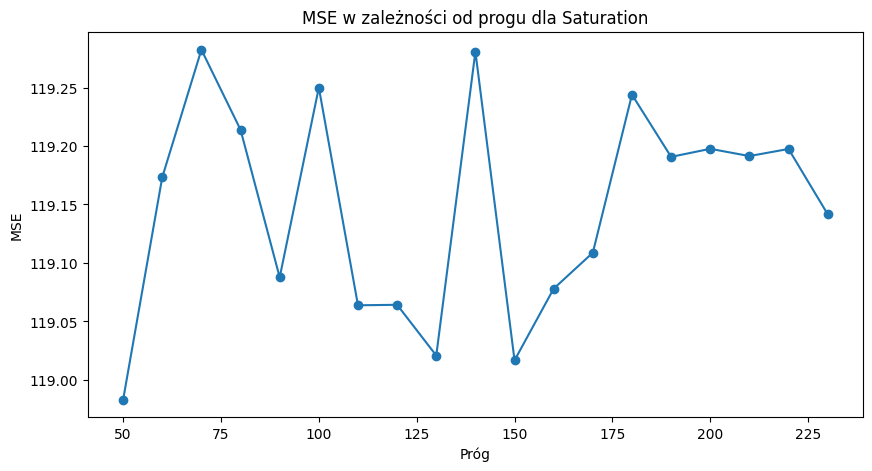

In [53]:
def mse_for_saturation():
    mse_values = []

    for t in range(50, 231, 10):
        ret, binary = cv2.threshold(saturation, t, 255, cv2.THRESH_BINARY_INV)
        mse = calculate_mse(saturation, binary)
        mse_values.append((t, mse))

    best_threshold = min(mse_values, key=lambda x: x[1])
    print(f"Najlepszy próg dla Saturation: {best_threshold[0]}, MSE: {best_threshold[1]}")

    thresholds_list, mse_list = zip(*mse_values)
    plt.figure(figsize=(10, 5))
    plt.plot(thresholds_list, mse_list, marker='o')
    plt.title('MSE w zależności od progu dla Saturation')
    plt.xlabel('Próg')
    plt.ylabel('MSE')
    plt.show()

mse_for_saturation()

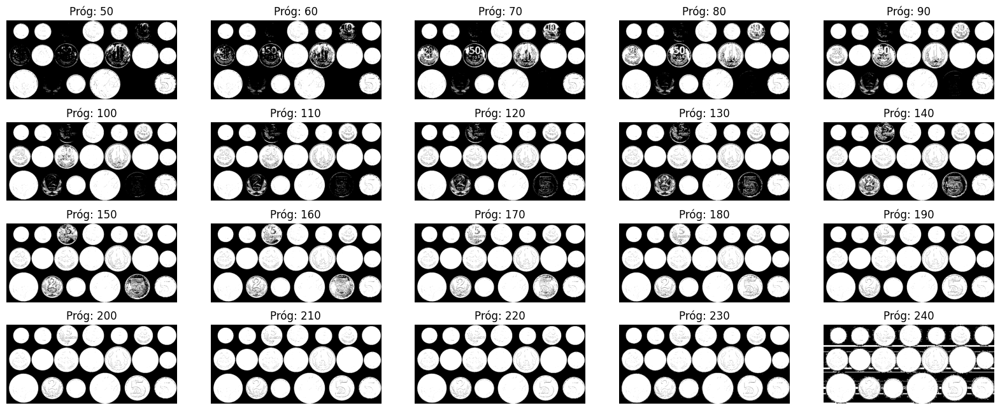

In [51]:
def display_binarized_images_saturation():
    plt.figure(figsize=(20, 10))
    num_plots = len(range(50, 241, 10))
    rows = (num_plots // 5) + 1

    for i, t in enumerate(range(50, 241, 10)):
        ret, binary = cv2.threshold(saturation, t, 255, cv2.THRESH_BINARY_INV)

        plt.subplot(rows, 5, i + 1)
        plt.title(f'Próg: {t}')
        plt.imshow(binary, cmap='gray')
        plt.axis('off')
    plt.show()

display_binarized_images_saturation()


Rozwiązanie części 2B:


In [54]:
monety_szum_hsv = cv2.cvtColor(monety_kolor_szum, cv2.COLOR_BGR2HSV)
hue_noise, saturation_noise, value_noise = cv2.split(monety_szum_hsv)

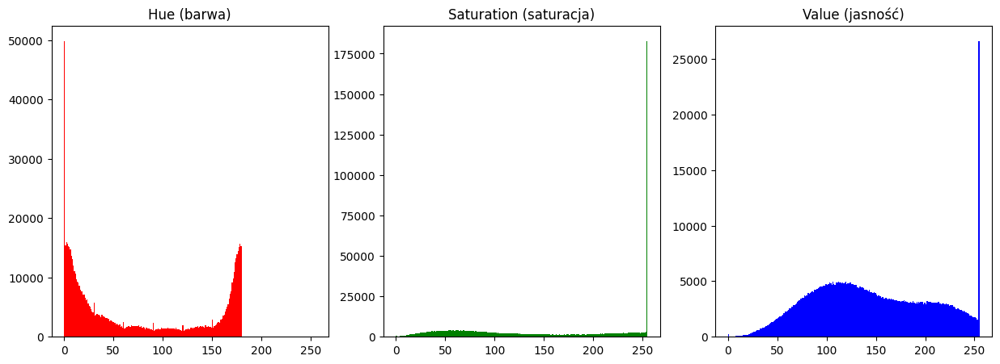

In [16]:
plt.figure(figsize=(15,5))
plt.subplot(1, 3, 1)
plt.title("Hue (barwa)")
plt.hist(hue_noise.flatten(), bins=255, color='red', range=(0, 255))

plt.subplot(1, 3, 2)
plt.title("Saturation (saturacja)")
plt.hist(saturation_noise.flatten(), bins=255, color='green', range=(0, 255))

plt.subplot(1, 3, 3)
plt.title("Value (jasność)")
plt.hist(value_noise.flatten(), bins=255, color='blue', range=(0, 255))

plt.show()

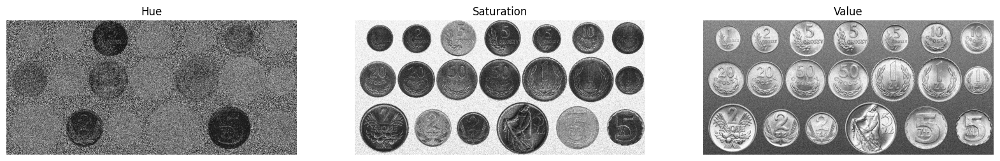

In [55]:
plt.figure(figsize=(20, 5))

plt.subplot(1, 3, 1)
plt.title(f"Hue")
plt.imshow(hue_noise, cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title(f"Saturation")
plt.imshow(saturation_noise, cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title(f"Value")
plt.imshow(value_noise, cmap='gray')
plt.axis('off')

plt.show()

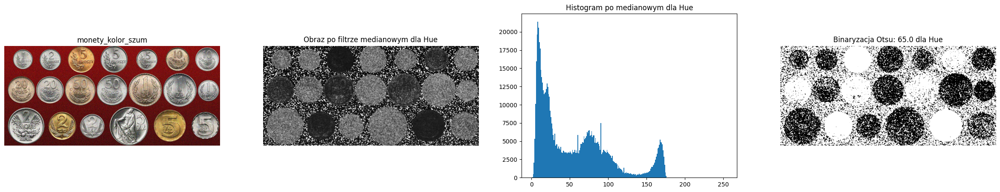

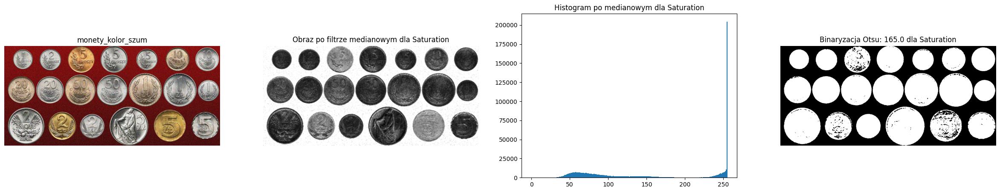

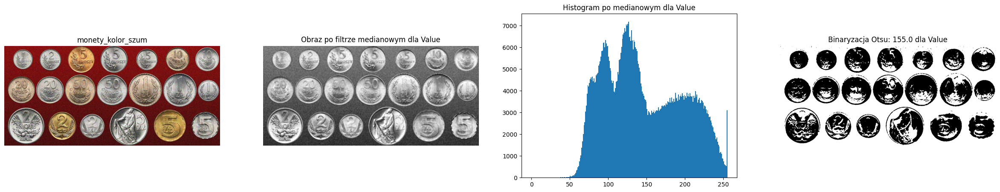

In [58]:
def channel_noise_func(channel, channel_name, picture, picture_name):
    median_filtered = cv2.medianBlur(channel, 5)
    ret, binary = cv2.threshold(median_filtered, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

    plt.figure(figsize=(30, 5))

    plt.subplot(1, 4, 1)
    plt.title(f'{picture_name}')
    plt.imshow(cv2.cvtColor(picture, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(1, 4, 2)
    plt.title(f'Obraz po filtrze medianowym dla {channel_name}')
    plt.imshow(median_filtered, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 4, 3)
    plt.title(f'Histogram po medianowym dla {channel_name}')
    plt.hist(median_filtered.flatten(), bins=255, range=(0, 255))

    plt.subplot(1, 4, 4)
    plt.title(f"Binaryzacja Otsu: {ret} dla {channel_name}")
    plt.imshow(binary, cmap='gray')
    plt.axis('off')

    plt.show()

channel_noise_func(hue_noise, 'Hue', monety_kolor_szum, 'monety_kolor_szum')
channel_noise_func(saturation_noise, 'Saturation', monety_kolor_szum, 'monety_kolor_szum')
channel_noise_func(value_noise, 'Value', monety_kolor_szum, 'monety_kolor_szum')


Najlepszy próg dla Saturation: 150, MSE: 76.1757380312531


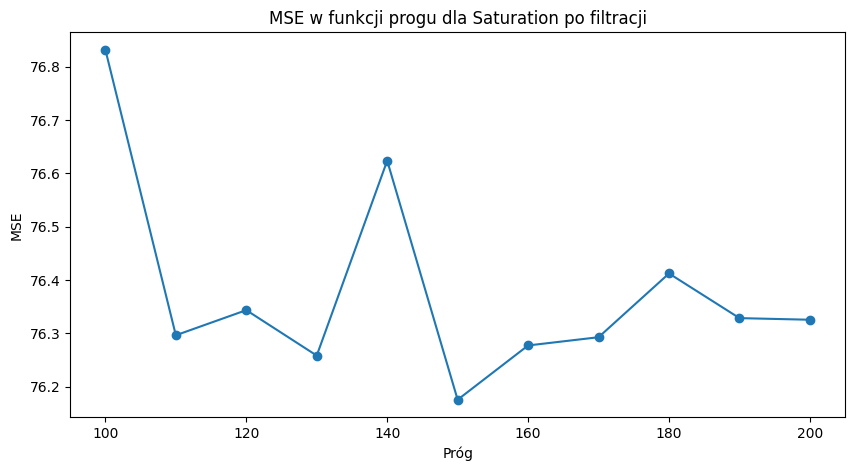

In [64]:
def mse_for_saturation_noise():
    mse_values = []

    for t in range(100, 201, 10):
        median_filtered = cv2.medianBlur(saturation_noise, 5)
        ret, binary = cv2.threshold(median_filtered, t, 255, cv2.THRESH_BINARY_INV)
        mse = calculate_mse(median_filtered, binary)
        mse_values.append((t, mse))

    best_threshold = min(mse_values, key=lambda x: x[1])
    print(f"Najlepszy próg dla Saturation: {best_threshold[0]}, MSE: {best_threshold[1]}")

    thresholds_list, mse_list = zip(*mse_values)
    plt.figure(figsize=(10, 5))
    plt.plot(thresholds_list, mse_list, marker='o')
    plt.title('MSE w funkcji progu dla Saturation po filtracji')
    plt.xlabel('Próg')
    plt.ylabel('MSE')
    plt.show()

mse_for_saturation_noise()


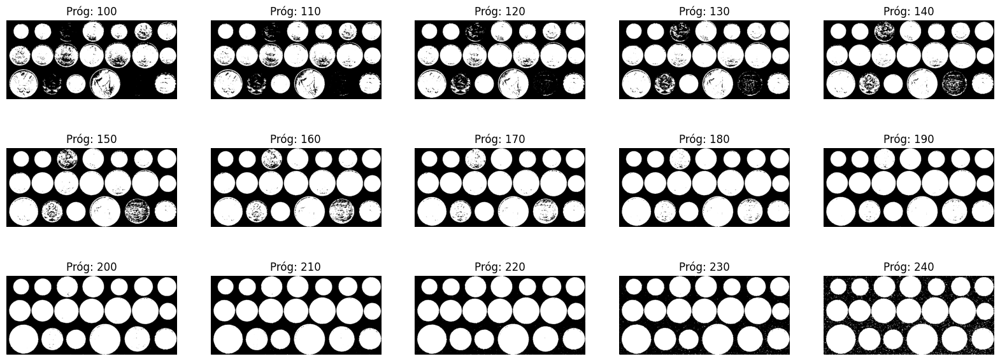

In [66]:
def display_binarized_images_saturation_noise():
    plt.figure(figsize=(20, 10))
    num_plots = len(range(100, 241, 10))
    rows = (num_plots // 5) + 1

    for i, t in enumerate(range(100, 241, 10)):
        median_filtered = cv2.medianBlur(saturation_noise, 5)
        ret, binary = cv2.threshold(median_filtered, t, 255, cv2.THRESH_BINARY_INV)

        plt.subplot(rows, 5, i + 1)
        plt.title(f'Próg: {t}')
        plt.imshow(binary, cmap='gray')
        plt.axis('off')
    plt.show()

display_binarized_images_saturation_noise()

##### Zad. 3: Tekst

W tym przypadku należy wyodrębnić litery od bardzo nierównomiernie oświetlonego tła. Skorzystaj z binaryzacji metodą Otsu. Zastosuj binaryzację w sposób lokalny (oknem przesuwnym). Jaki wpływ ma rozmiar okna na jakość binaryzacji? Jak przesuwać okno?

_(Pełna punktacja za zadanie wymaga własnoręcznej implementacji okna przesuwnego i filtracji wewnątrz niego. Użycie zamiast tego_ `cv2.adaptiveThreshold` _liczone jako pół zadania, przy założeniu zrozumienia tej metody.)_

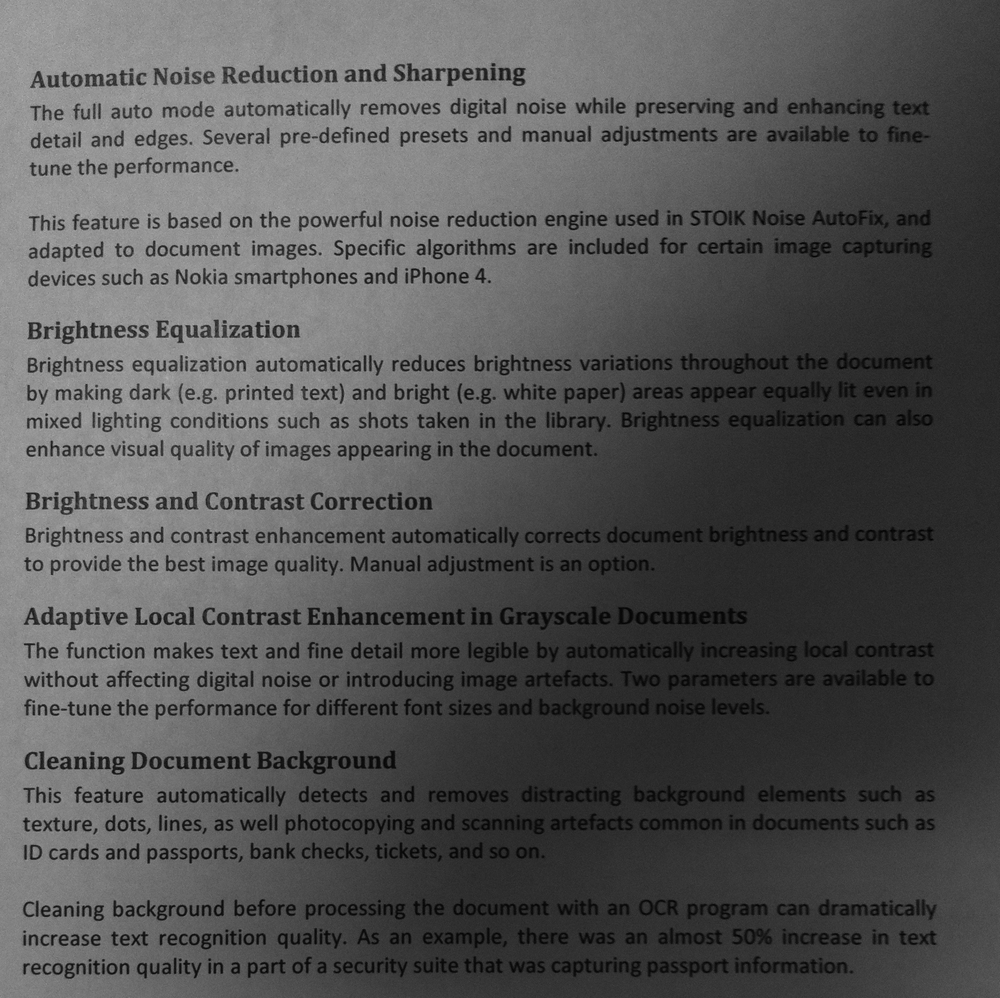

In [67]:
tekst = cv2.imread('Tekst1.bmp')
Image.fromarray(cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY))

Rozwiązanie:

In [110]:
def self_adaptive_threshold(image, size, C):

    w_height, w_width = (size, size)
    h, w = image.shape
    binary_image = np.zeros_like(image)

    for y in range(0, h, w_height):
        for x in range(0, w, w_width):

            window = image[y:y + w_height, x:x + w_width]
            T, _ = cv2.threshold(window, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
            T -= C if T >= C else 0
            ret, local_th = cv2.threshold(window, T, 255, type=cv2.THRESH_BINARY_INV)
            binary_image[y:y + w_height, x:x + w_width] = local_th

    return binary_image

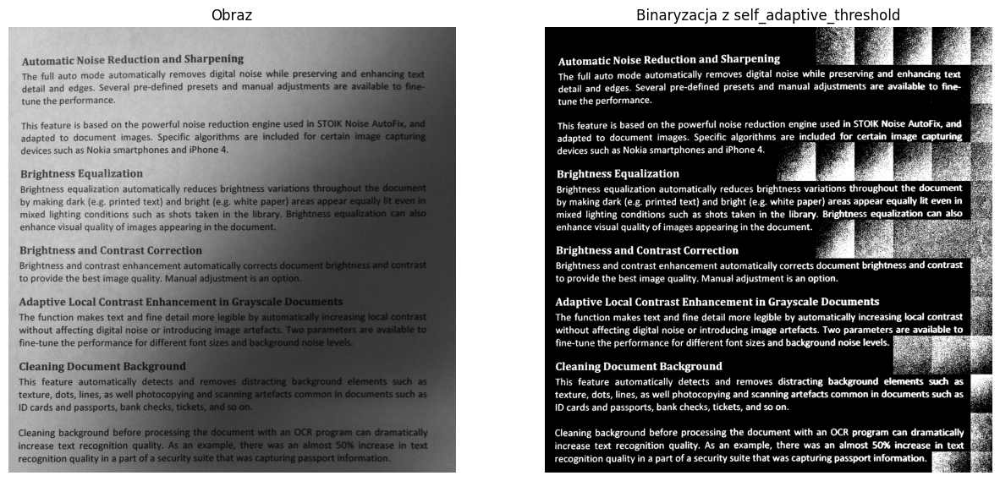

In [113]:
gray_text = cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY)
binary_image = self_adaptive_threshold(gray_text, size=150, C=0)

plt.figure(figsize=(15, 10))
plt.subplot(1, 2, 1)
plt.title('Obraz')
plt.imshow(gray_text, cmap='gray')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Binaryzacja z self_adaptive_threshold')
plt.imshow(binary_image, cmap='gray')
plt.axis('off')

plt.show()

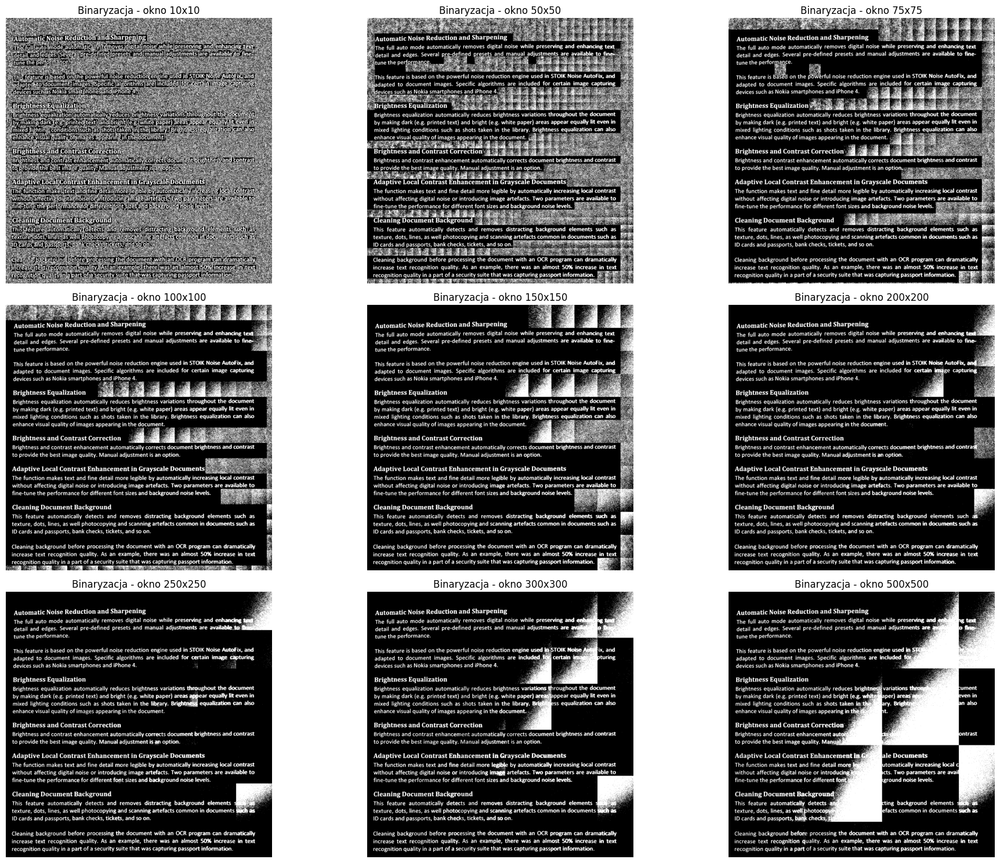

In [114]:
window_sizes = [10, 50, 75, 100, 150, 200, 250, 300, 500]

plt.figure(figsize=(20, 15))
for i, size in enumerate(window_sizes):
    binary_image = self_adaptive_threshold(gray_text, size, C=0)

    plt.subplot(3, 3, i + 1)
    plt.title(f"Binaryzacja - okno {size}x{size}")
    plt.imshow(binary_image, cmap='gray')
    plt.axis('off')

plt.tight_layout()
plt.show()

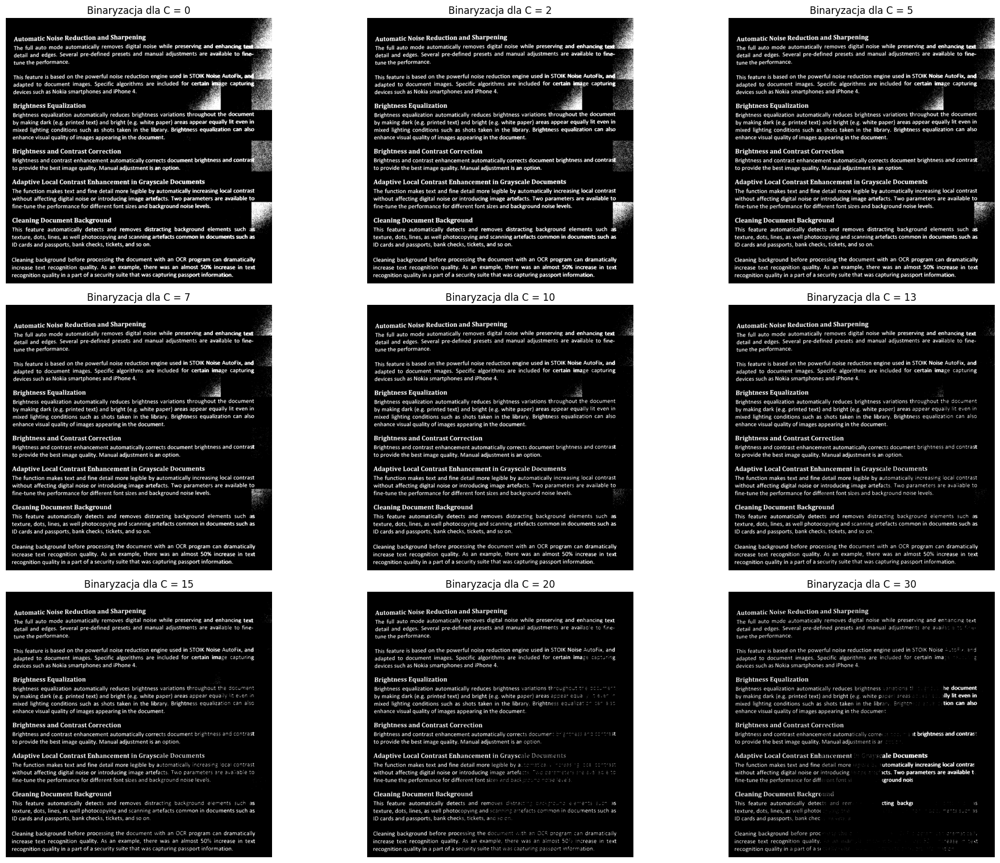

In [123]:
Cs = [0, 2, 5, 7, 10, 13, 15, 20, 30]

plt.figure(figsize=(20, 15))
for i, c in enumerate(Cs):
    binary_image = self_adaptive_threshold(gray_text, size=200, C=c)

    plt.subplot(3, 3, i + 1)
    plt.title(f"Binaryzacja dla C = {c}")
    plt.imshow(binary_image, cmap='gray')
    plt.axis('off')

plt.tight_layout()
plt.show()

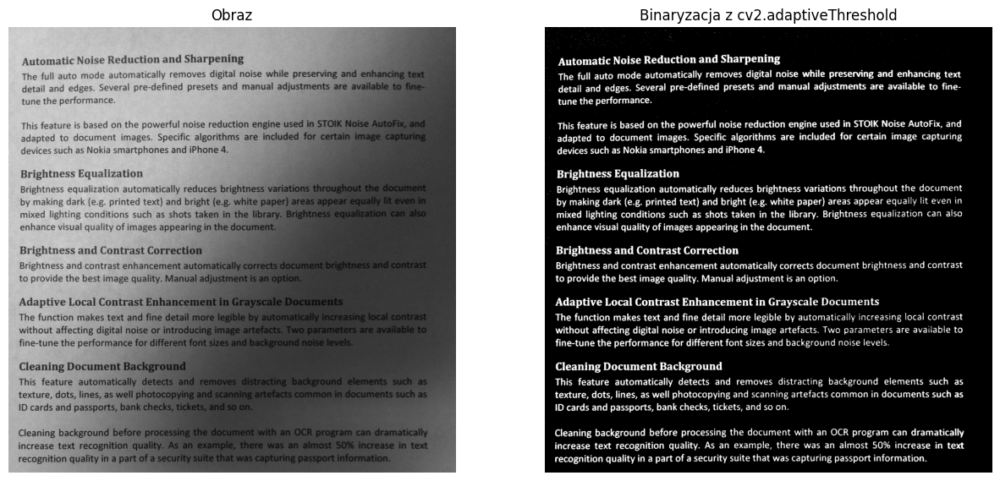

In [130]:
binary_image = cv2.adaptiveThreshold(gray_text, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                                               cv2.THRESH_BINARY_INV, blockSize=201, C=18)

plt.figure(figsize=(15, 10))
plt.subplot(1, 2, 1)
plt.title('Obraz')
plt.imshow(gray_text, cmap='gray')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Binaryzacja z cv2.adaptiveThreshold')
plt.imshow(binary_image, cmap='gray')
plt.axis('off')

plt.show()
